# **LLE_UNET INFERENCE UNDERWATER**

Date - 03/08/2023

Images - EUVP (Enhancing Underwater Visual Perception) Datset Images

In [1]:
import os
import random
import csv

In [2]:
import cv2
import sys
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import math
import random


import tensorflow as tf
from tensorflow.keras.layers import Dense, Activation, Concatenate, GlobalAveragePooling2D, Multiply,GlobalMaxPooling2D
from tensorflow.keras.layers import Conv2D, BatchNormalization, MaxPool2D, Conv2DTranspose, Input
from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg16 import VGG16

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: l

In [3]:
# set Radndom Seed
SEED = 0
np.random.seed(SEED)
tf.random.set_seed(SEED)
tf.config.run_functions_eagerly(True)

In [4]:
# Load train test validation image paths form csv files 
def load_excel_data(file_path, column1_name='UnderWater Images', column2_name='GroundTruth Images', sheet_name="Sheet1"):
    try:
        # Load the Excel file
        df = pd.read_csv(file_path)

        # Extract the data from the specified columns
        column1_data = df[column1_name].tolist()
        column2_data = df[column2_name].tolist()

        return column1_data, column2_data

    except Exception as e:
        print(f"Error occurred while loading data from Excel: {e}")
        return None, None

In [5]:
train_csv_path = r'/kaggle/input/train-lle-unet-for-underwater/train.csv'
test_csv_path = r'/kaggle/input/train-lle-unet-for-underwater/test.csv'
validation_csv_path = r'/kaggle/input/train-lle-unet-for-underwater/validation.csv'

In [6]:
train_x_paths, train_y_paths = load_excel_data(train_csv_path)
val_x_paths, val_y_paths = load_excel_data(validation_csv_path)
test_x_paths, test_y_paths = load_excel_data(test_csv_path)

In [7]:
train_x_paths = sorted(train_x_paths)
train_y_paths = sorted(train_y_paths)
val_x_paths = sorted(val_x_paths)
val_y_paths = sorted(val_y_paths)
test_x_paths = sorted(test_x_paths)
test_y_paths = sorted(test_y_paths)


In [8]:
print(f'X_train : {len(train_x_paths)}')
print(f'Y_train : {len(train_y_paths)}')
print(f'X_val   : {len(val_x_paths)}')
print(f'Y_val   : {len(val_y_paths)}')
print(f'X_test  : {len(test_x_paths)}')
print(f'Y_test  : {len(test_y_paths)}')

X_train : 9148
Y_train : 9148
X_val   : 1143
Y_val   : 1143
X_test  : 1144
Y_test  : 1144


### **Create Model**

In [9]:
def channel_attention_module(x, ratio=8):
    batch, _, _, channel = x.shape

    ## Shared layers
    l1 = Dense(channel//ratio, activation="relu", use_bias=False)
    l2 = Dense(channel, use_bias=False)

    ## Global Average Pooling
    x1 = GlobalAveragePooling2D()(x)
    x1 = l1(x1)
    x1 = l2(x1)

    ## Global Max Pooling
    x2 = GlobalMaxPooling2D()(x)
    x2 = l1(x2)
    x2 = l2(x2)

    ## Add both the features and pass through sigmoid
    feats = x1 + x2
    feats = Activation("sigmoid")(feats)
    feats = Multiply()([x, feats])

    return feats

def spatial_attention_module(x):
    ## Average Pooling
    x1 = tf.reduce_mean(x, axis=-1)
    x1 = tf.expand_dims(x1, axis=-1)

    ## Max Pooling
    x2 = tf.reduce_max(x, axis=-1)
    x2 = tf.expand_dims(x2, axis=-1)

    ## Concatenat both the features
    feats = Concatenate()([x1, x2])
    ## Conv layer
    feats = Conv2D(1, kernel_size=7, padding="same", activation="sigmoid")(feats)
    feats = Multiply()([x, feats])

    return feats

def CBAM(x):
    x = channel_attention_module(x)
    x = spatial_attention_module(x)
    return x

In [10]:
def conv_block(input, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(input)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x

def encoder_block(input, num_filters):
    x = conv_block(input, num_filters)
    p = MaxPool2D((2, 2))(x)
    return x, p

def decoder_block(input, skip_features, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
    x = Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x

def build_model(input_shape):
    inputs = Input(input_shape)

    vgg_model = VGG16(include_top=False, weights="imagenet",input_tensor=inputs)
    vgg_model.trainable = False

    # Encoder
    s1 = vgg_model.get_layer("block1_conv2").output                             ## (512 x 512)
    s2 = vgg_model.get_layer("block2_conv2").output                             ## (256 x 256)
    s3 = vgg_model.get_layer("block3_conv3").output                             ## (128 x 128)
    s4 = vgg_model.get_layer("block4_conv3").output                             ## (64 x 64)

    b1 = vgg_model.get_layer("block5_conv3").output                             ## (32 x 32)

    # Attention
    s1 = CBAM(s1)
    s2 = CBAM(s2)
    s3 = CBAM(s3)
    s4 = CBAM(s4)

    # Decoder
    d1 = decoder_block(b1, s4, 512)                                             ## (64 x 64)
    d2 = decoder_block(d1, s3, 256)                                             ## (128 x 128)
    d3 = decoder_block(d2, s2, 128)                                             ## (256 x 256)
    d4 = decoder_block(d3, s1, 64)                                              ## (512 x 512)

    # Output
    outputs = Conv2D(3, 1, padding="same", activation="sigmoid")(d4)

    model = Model(inputs, outputs, name="LLE_UNET_undwerwater")
    return model


In [11]:
input_shape = (None, None, 3)
model = build_model(input_shape)
model.summary()

58889256/58889256 [==============================] - 2s 0us/step
Model: "LLE_UNET_undwerwater"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 block1_conv1 (Conv2D)          (None, None, None,   1792        ['input_1[0][0]']                
                                64)                                                               
                                                                                                  
 block1_conv2 (Conv2D)          (None, None, None,   36928       ['block1_conv1[0][0]']           
              

In [12]:
#optimizer = tf.keras.optimizers.experimental.AdamW(learning_rate=0.0001,weight_decay=0.004)
optimizer = tf.keras.optimizers.Adam(learning_rate=3e-4)
MSEloss = tf.keras.losses.MeanSquaredError()

def charbonnier_loss(y_true, y_pred):
    return tf.reduce_mean(tf.sqrt(tf.square(y_true - y_pred) + tf.square(1e-3)))

def psnr_loss_fn(y_true, y_pred):
    return tf.image.psnr(y_pred, y_true, max_val=1.0)

def ssim_loss_fn(y_true,y_pred):
    return tf.image.ssim(y_true,y_pred,1.0)

In [13]:
model_path = r'/kaggle/input/train-lle-unet-for-underwater/LLE_UNET_UNDWERWATER.h5'

In [14]:
from keras.models import load_model
model = load_model(model_path,custom_objects={'charbonnier_loss': charbonnier_loss,
                                              'psnr_loss_fn':psnr_loss_fn,
                                              'ssim_loss_fn':ssim_loss_fn},
                                              compile = False)

### **Preprocessing Functions**

In [15]:
def padding_calc(input_dim,multiplier=32):
    return math.ceil(input_dim/multiplier)*multiplier - input_dim

def pad_image(image,mood = "center_padding"):
    img_h = image.shape[0]
    img_w = image.shape[1]

    pad_y = padding_calc(img_h)
    pad_x = padding_calc(img_w)

    if mood == "center_padding":
        pad_y2 = pad_y//2
        pad_x2 = pad_x//2

        padded_img = image.copy()
        if pad_y%2 != 0:
            padded_img = np.pad(image, ((pad_y2, pad_y2+1), (pad_x2, pad_x2), (0, 0)), mode='constant')
        if pad_x%2 != 0:
            padded_img = np.pad(image, ((pad_y2, pad_y2), (pad_x2, pad_x2+1), (0, 0)), mode='constant')
        if (pad_y%2 == 0) & (pad_x%2 == 0):
            padded_img = np.pad(image, ((pad_y2, pad_y2), (pad_x2, pad_x2), (0, 0)), mode='constant')

    elif mood == "corner_padding":
        padded_img = np.pad(image, ((0, pad_y), (0, pad_x), (0, 0)), mode='constant')
    return padded_img

def inverse_padding(pad_image,image_dim,pad_method="center_padding"):
  pad_img_height = pad_image.shape[0]
  pad_img_width = pad_image.shape[1]

  img_height = image_dim[0]
  img_width = image_dim[1]

  if pad_method == "center_padding":
    pad_y1 = (pad_img_height - img_height)//2
    if pad_y1*2 == (pad_img_height - img_height):pad_y2 = pad_y1
    else: pad_y2 = pad_y1+1

    pad_x1 = (pad_img_width - img_width)//2
    if pad_x1*2 == (pad_img_width - img_width):pad_x2 = pad_x1
    else: pad_x2 = pad_x1+1
    extract_image = pad_image[pad_y1:pad_img_height-pad_y2,pad_x1:pad_img_width-pad_x2]

  if pad_method == "corner_padding":
    extract_image = pad_image[0:img_height,0:img_width]


  return extract_image

In [16]:
def preprocess_image(img_path):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img,(256,256))
    preprocess_img = pad_image(img)
    preprocess_img = preprocess_img/255;
    return preprocess_img

**Inference**

In [17]:
results_save_dir = r'/kaggle/working/'

In [18]:
def infer(x_paths,y_paths,n_images,save_sufix='res',save=False):
    for i,x_image_path in enumerate(x_paths):
        if i == n_images:
            break
        print(f'{i+1}/{n_images} : {x_image_path}')
        x_img = preprocess_image(x_image_path)
        prediction = model.predict(np.expand_dims(x_img,axis=0),verbose=0)

        y_img_path = y_paths[i]
        y_img = preprocess_image(y_img_path)

        fig, ax = plt.subplots(ncols=3, figsize=(15,10));
        ax[0].imshow(x_img);
        ax[1].imshow(prediction[0]);
        ax[2].imshow(y_img);
        ax[0].axis('off');
        ax[1].axis('off');
        ax[2].axis('off');
        ax[0].set_title("UnderWater Image")
        ax[1].set_title("Predicted Image")
        ax[2].set_title("GroundTruth Image")
        save_path = os.path.join(results_save_dir,f'{save_sufix}_{i}.png')
        plt.savefig(save_path, bbox_inches='tight', pad_inches=0)
        plt.show()

1/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264288_00012917.jpg


/opt/conda/lib/python3.10/site-packages/tensorflow/python/data/ops/structured_function.py:254: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


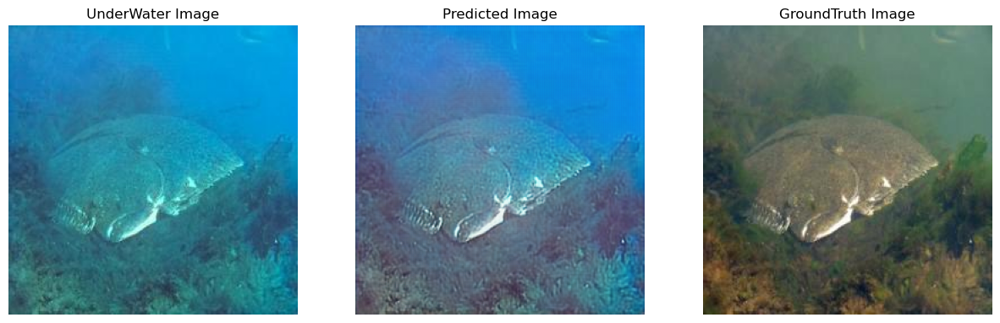

2/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264303_n02526121_4809.JPEG


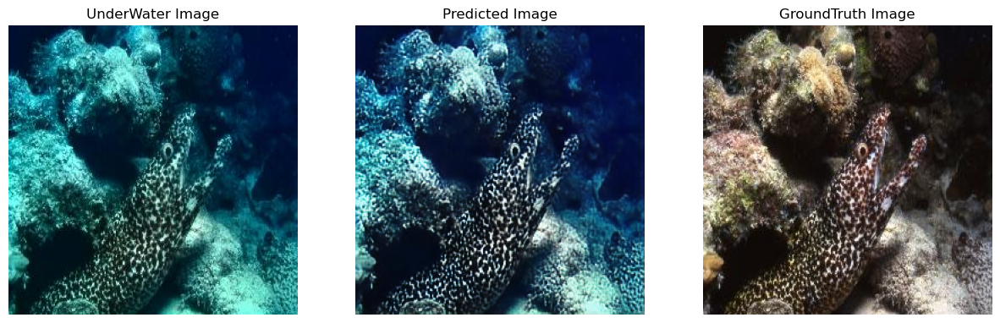

3/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264348_n02655020_9849.JPEG


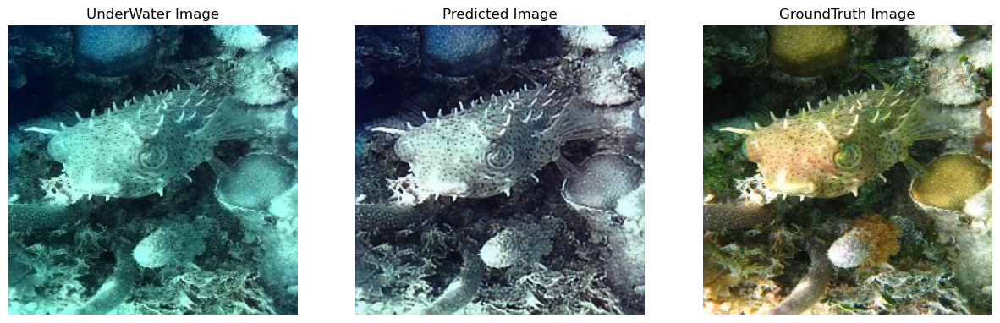

4/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264365_scuba_thanksgiving_520.jpg


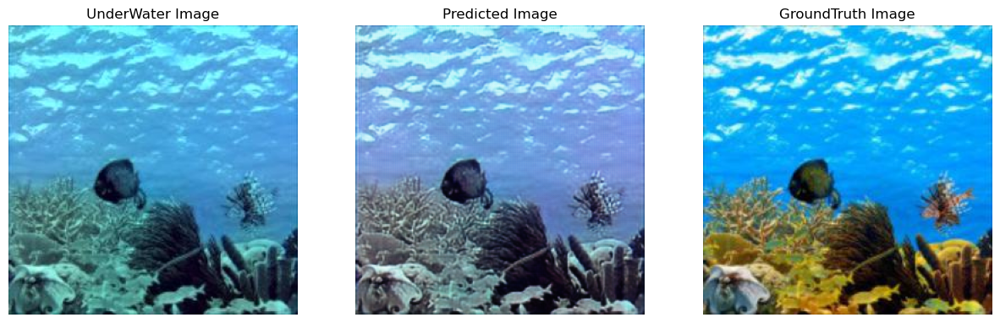

5/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264367_00022286.jpg


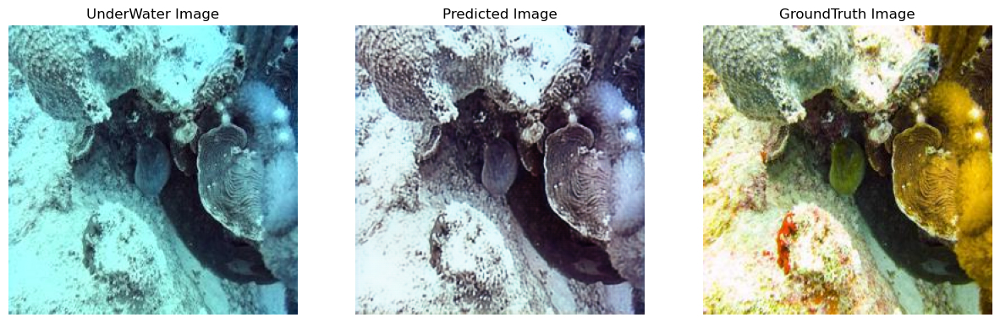

6/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264369_00011297.jpg


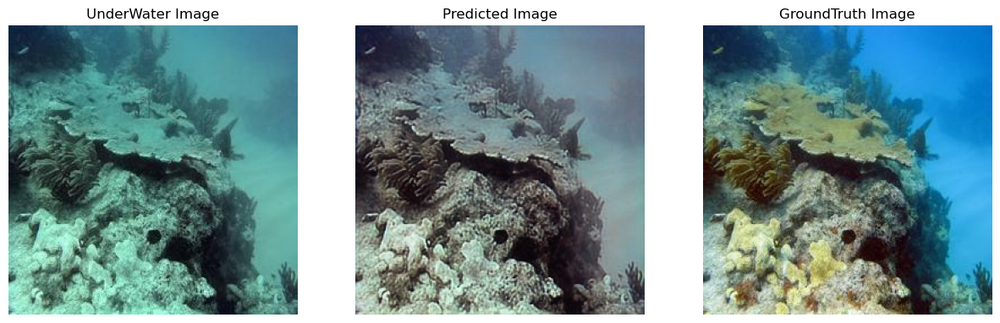

7/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264400_00022977.jpg


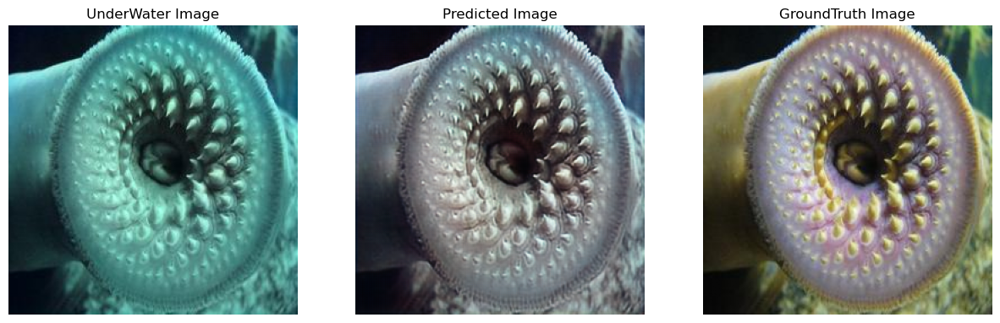

8/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264433_00031637.jpg


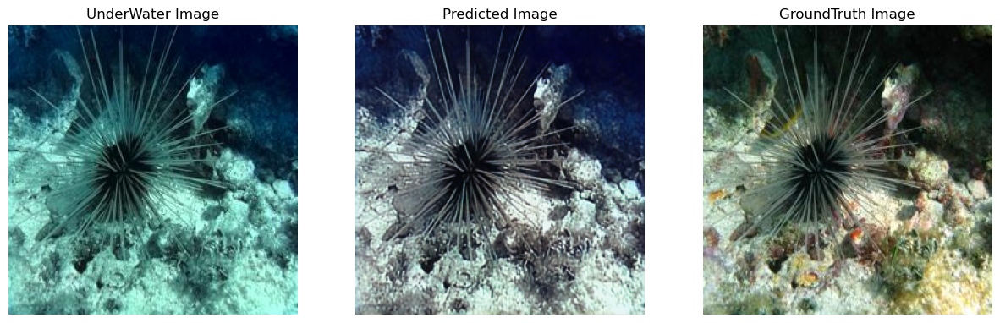

9/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264443_n02655020_14093.JPEG


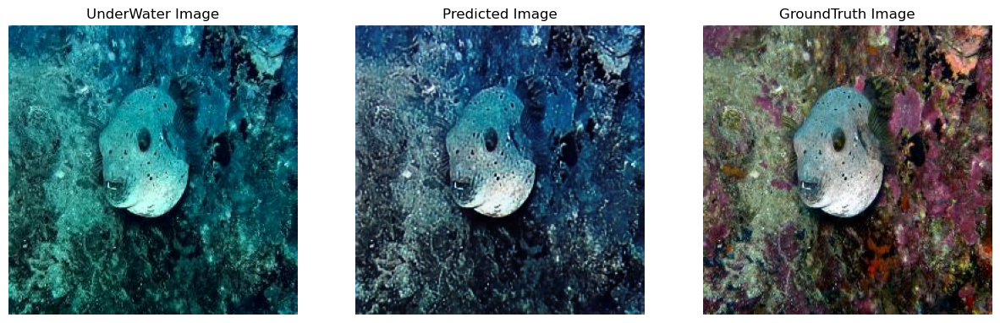

10/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264460_n09256479_3820.JPEG


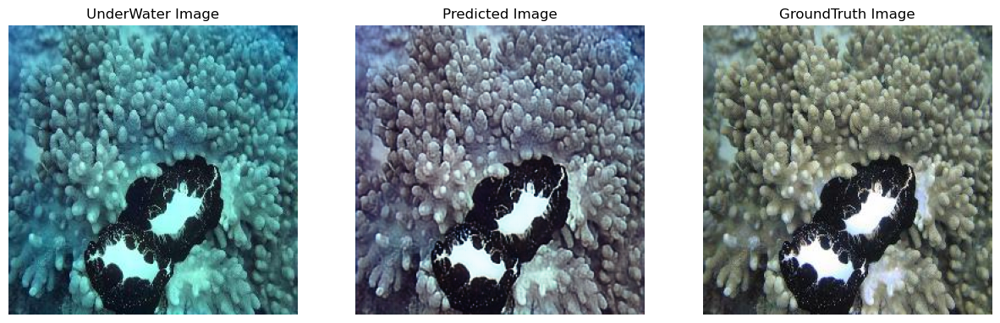

11/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264464_00034147.jpg


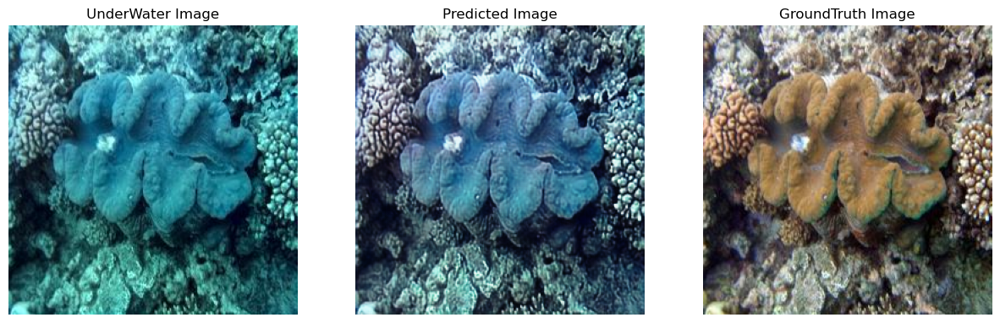

12/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264476_n01924916_8820.JPEG


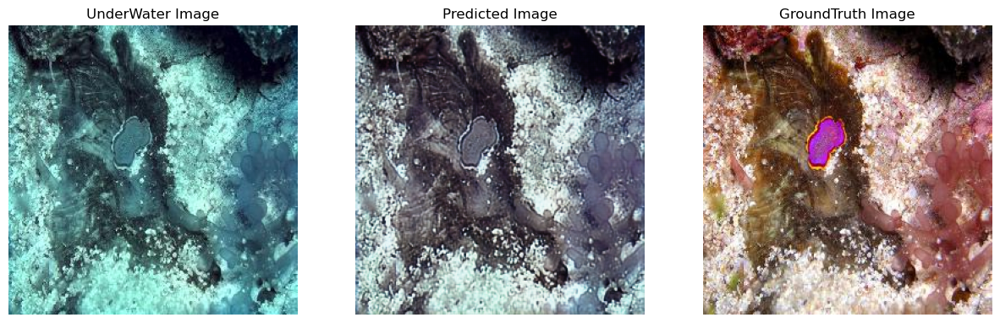

13/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264481_sea_turtle_adorable_429.jpg


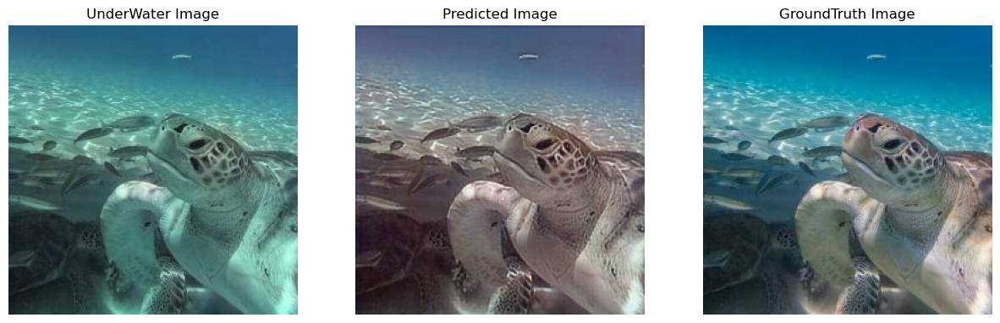

14/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264522_n01950731_1115.JPEG


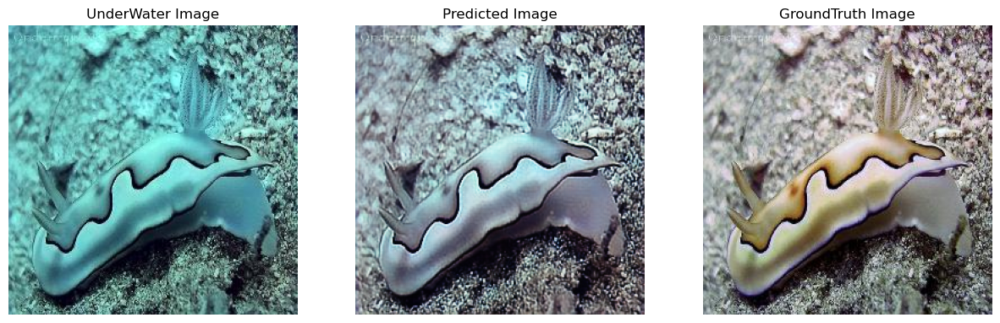

15/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264525_n01751748_11165.JPEG


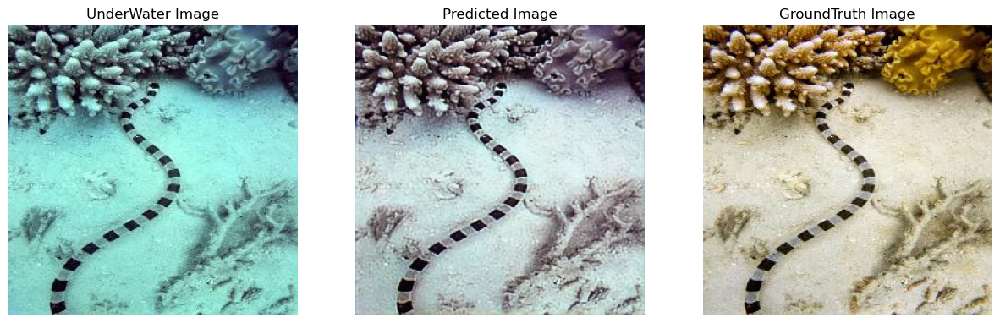

16/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264533_00015663.jpg


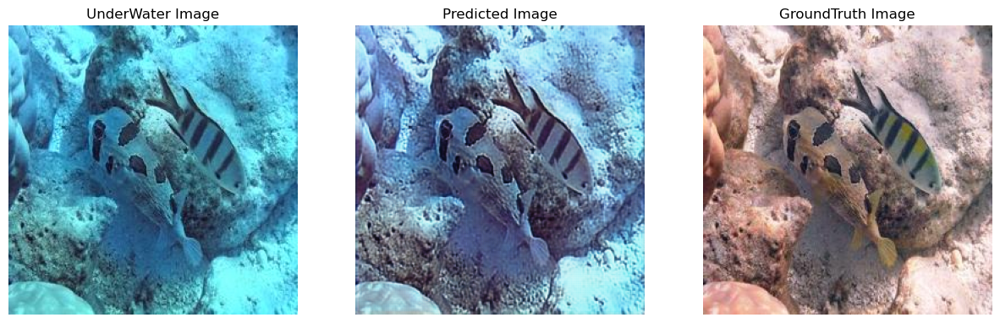

17/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264550_00027308.jpg


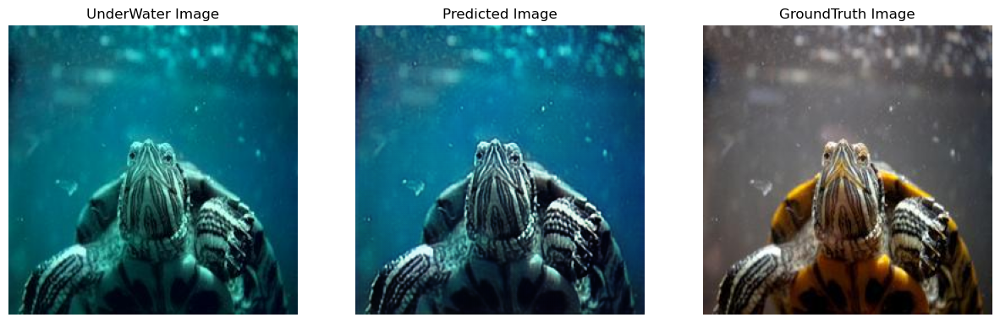

18/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264574_00031858.jpg


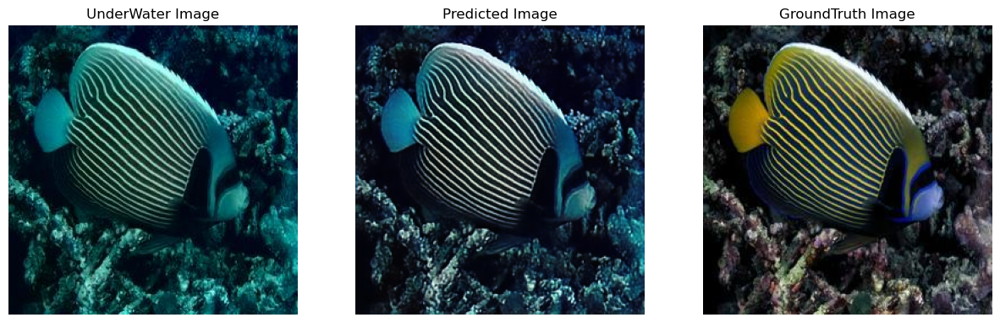

19/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264577_00018648.jpg


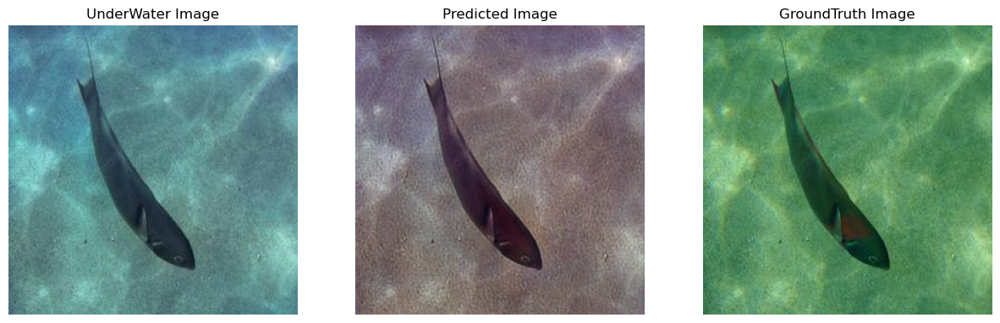

20/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264581_n01910747_1280.JPEG


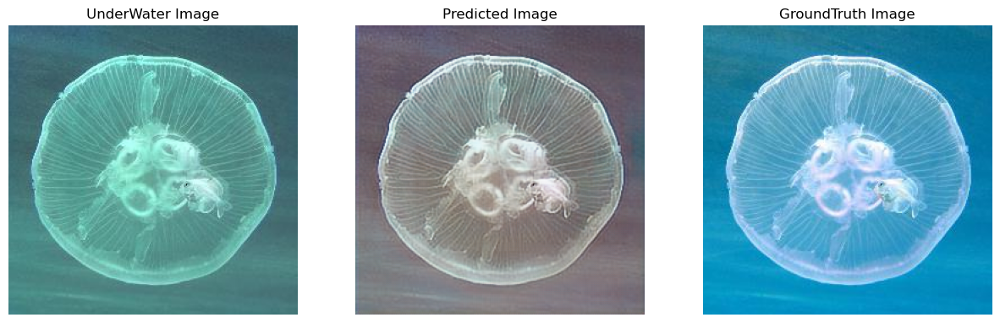

21/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264589_00017027.jpg


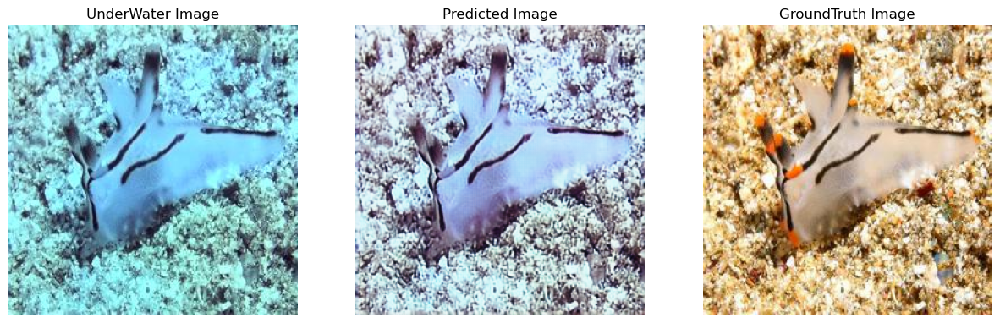

22/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264615_00023774.jpg


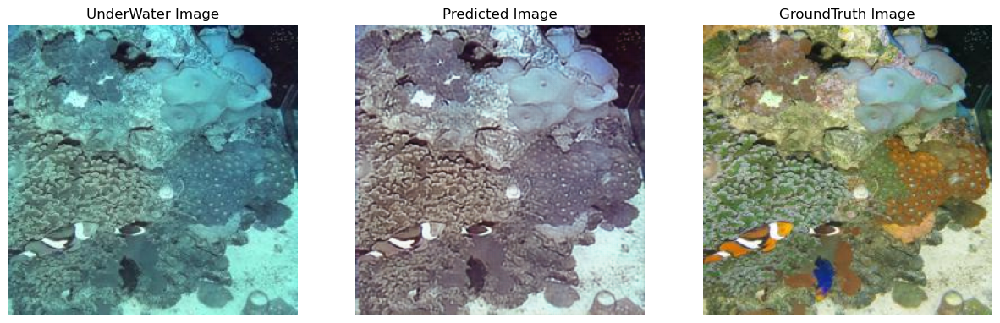

23/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264619_00034243.jpg


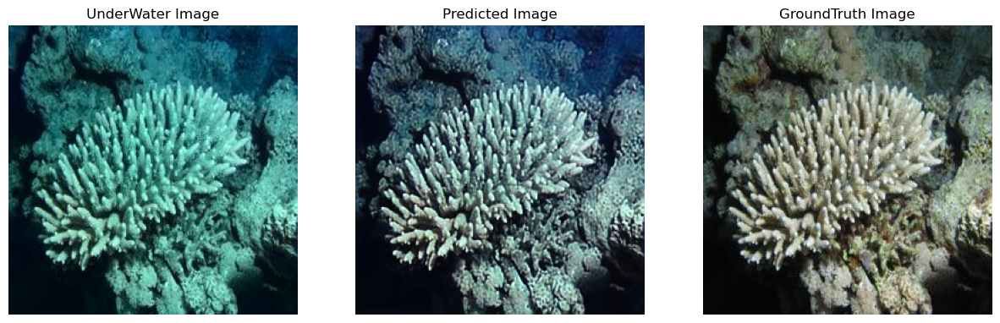

24/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264631_00030807.jpg


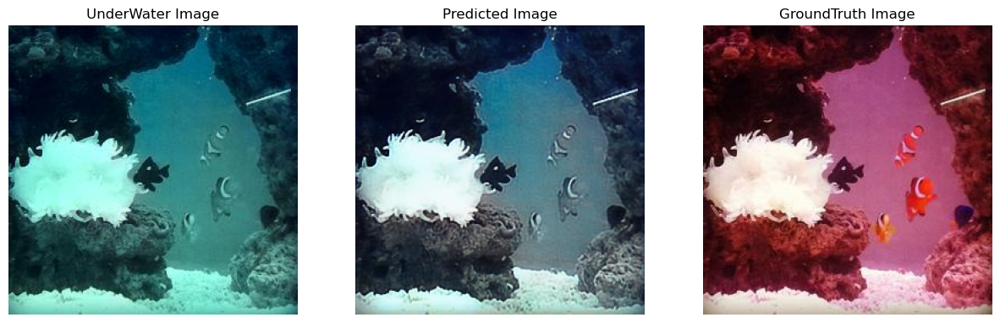

25/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264654_00018807.jpg


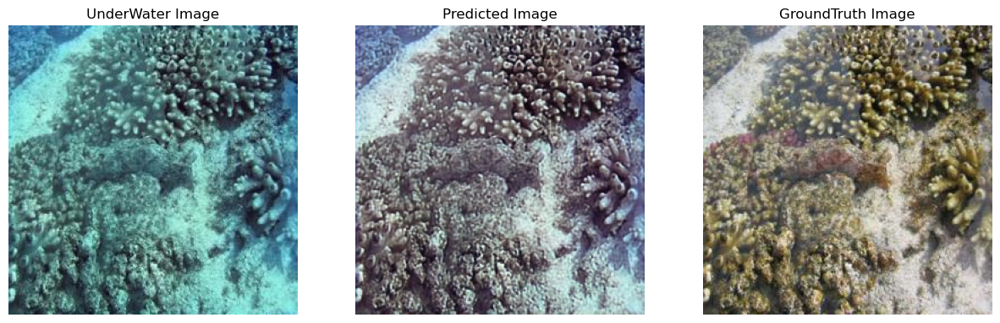

In [19]:
# on test images
infer(test_x_paths,test_y_paths,n_images=25,save=True)

1/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264286_00007889.jpg


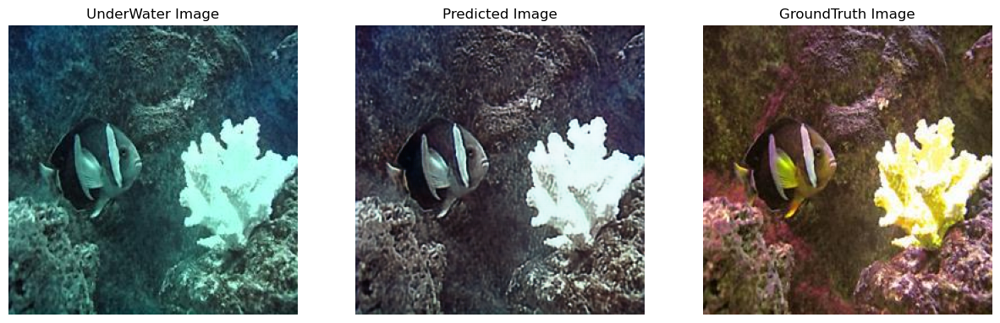

2/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264287_00007863.jpg


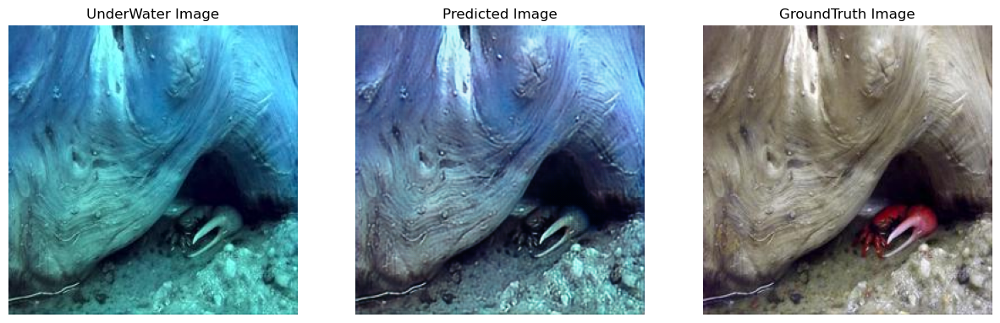

3/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264293_00038238.jpg


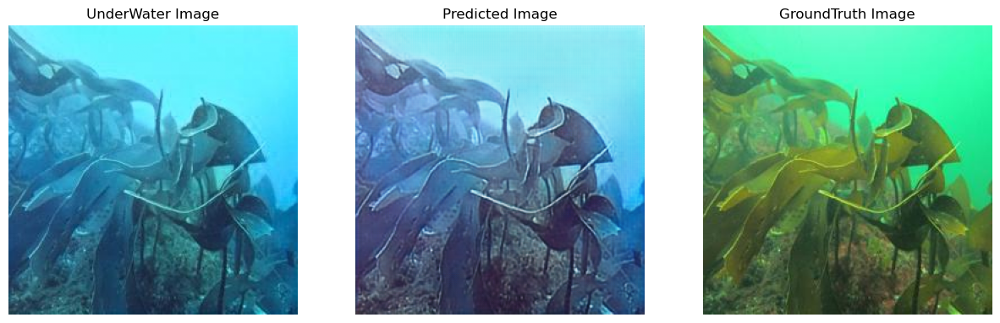

4/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264294_00027762.jpg


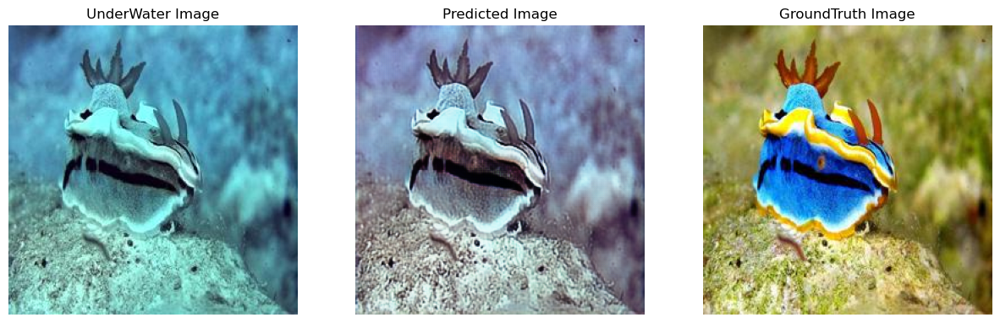

5/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264296_n02319095_1106.JPEG


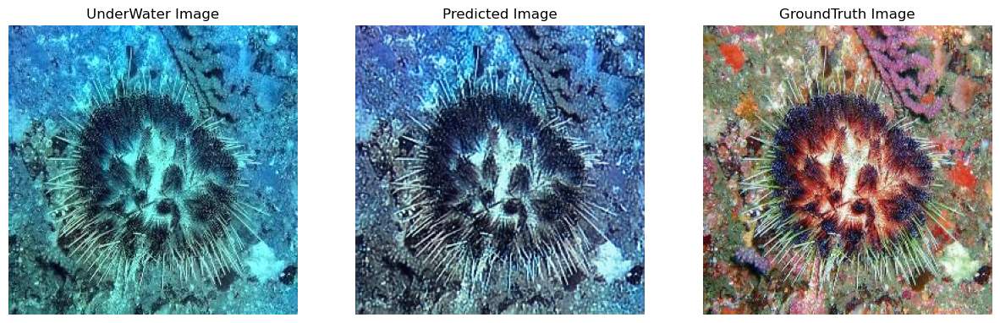

6/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264298_00035269.jpg


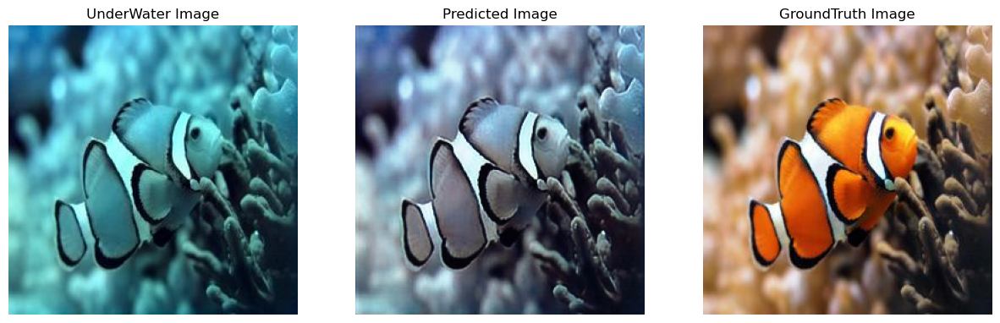

7/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264307_n02317335_6744.JPEG


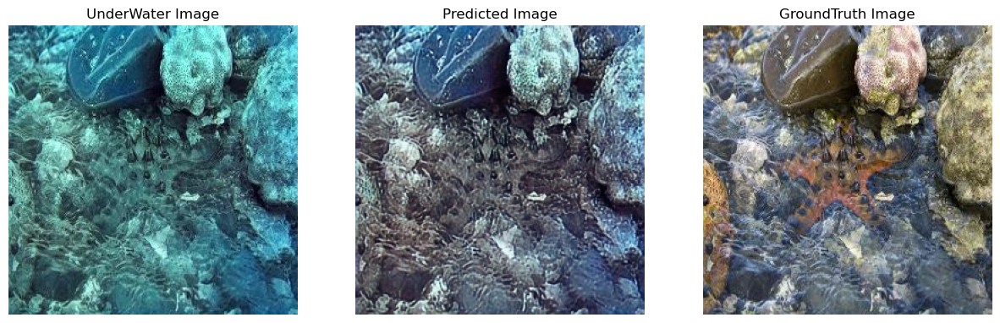

8/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264310_n01924916_8467.JPEG


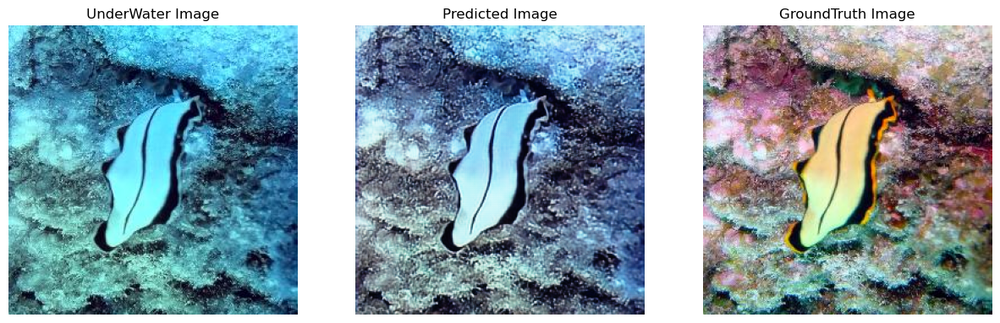

9/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264311_n02607072_51.JPEG


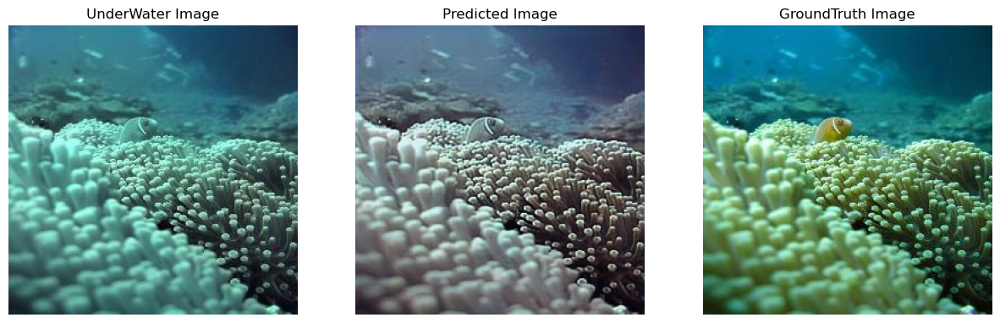

10/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264316_n01924916_1597.JPEG


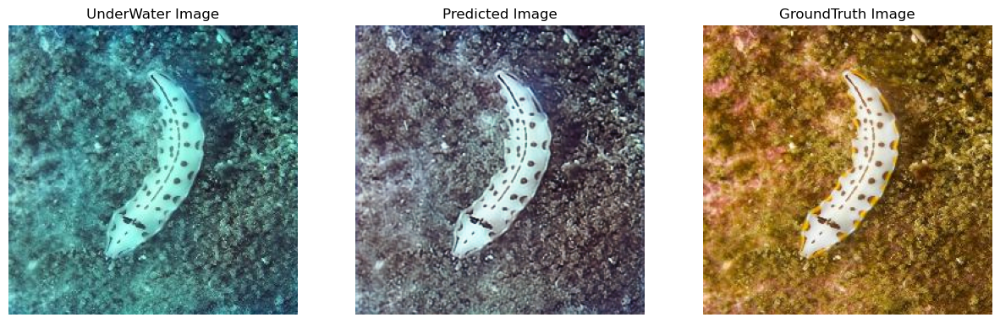

11/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264318_n02655020_17544.JPEG


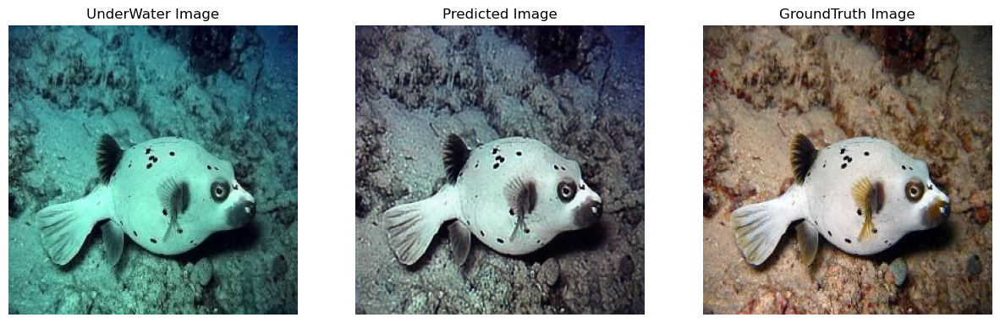

12/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264322_n01917289_4196.JPEG


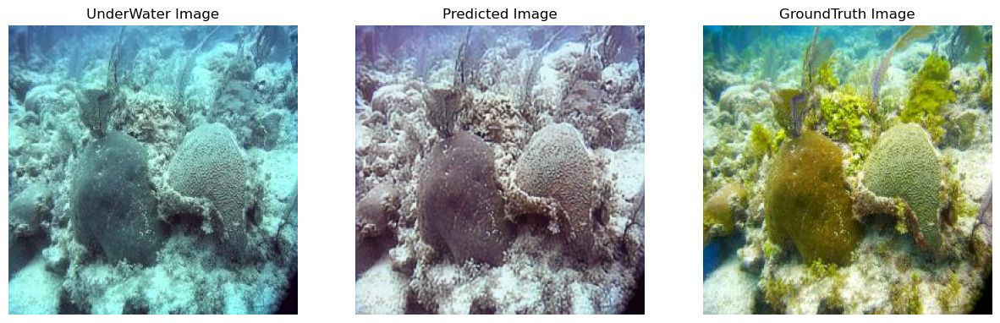

13/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264328_00004694.jpg


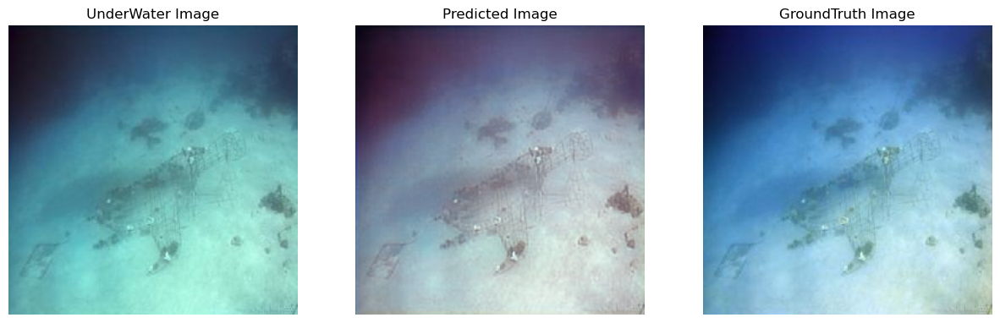

14/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264332_00012132.jpg


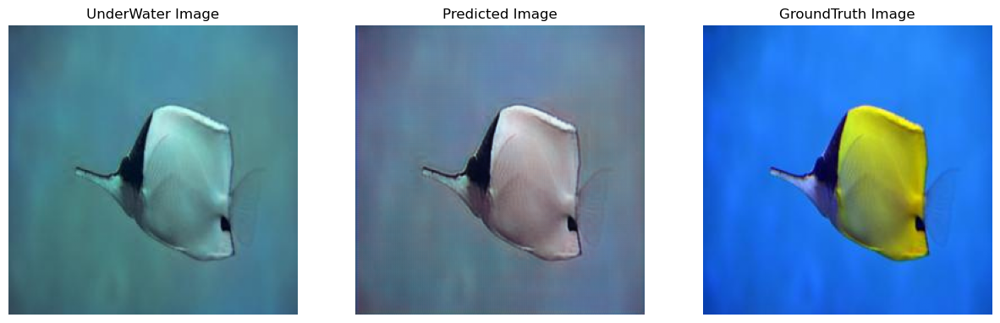

15/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264343_n01950731_11838.JPEG


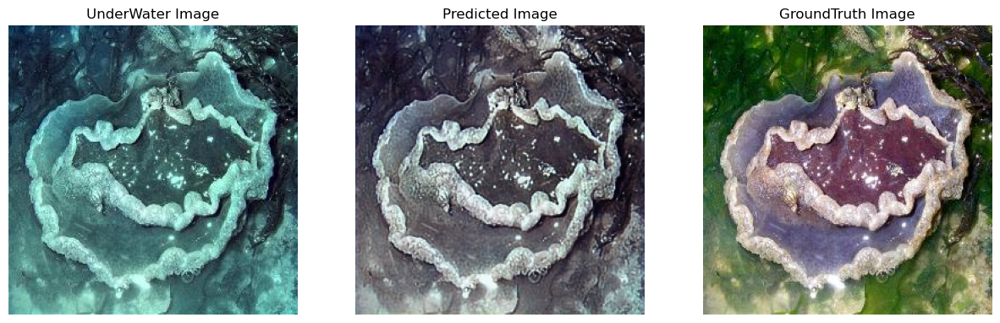

16/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264344_00027786.jpg


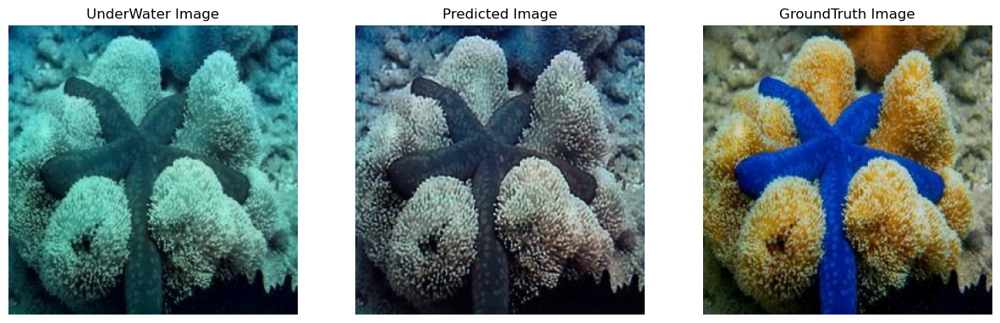

17/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264346_n01917289_4496.JPEG


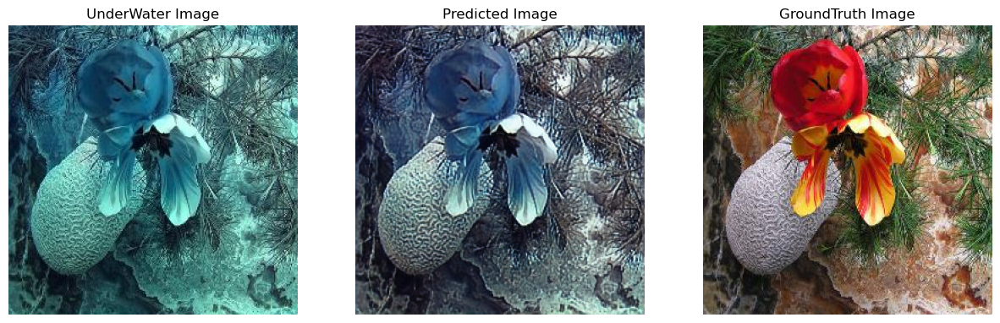

18/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264362_n02319095_6222.JPEG


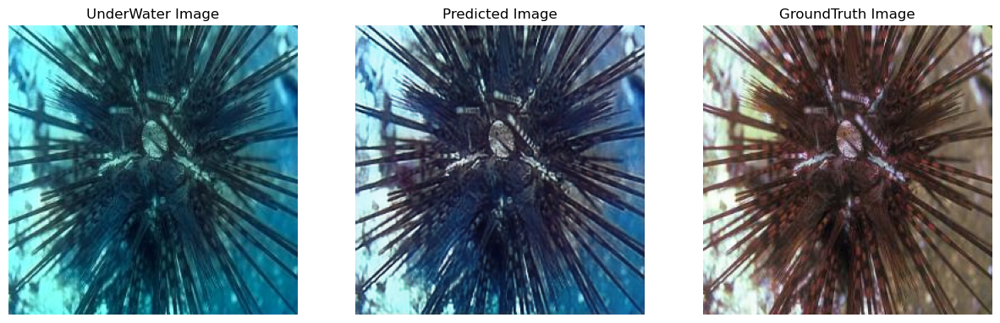

19/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264366_00033180.jpg


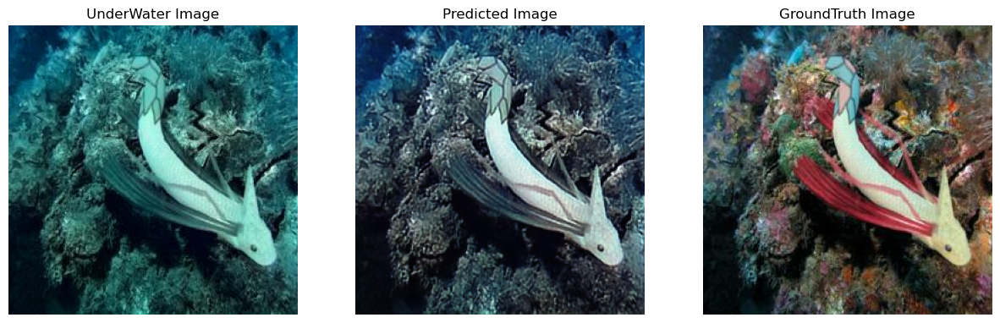

20/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264368_n02607072_398.JPEG


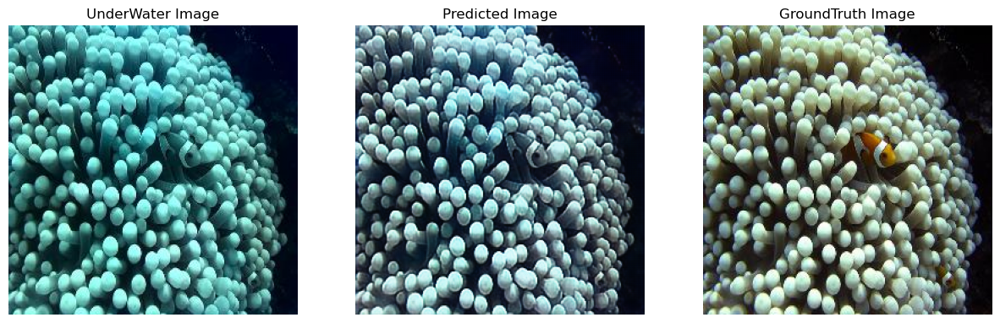

21/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264373_n02319095_4789.JPEG


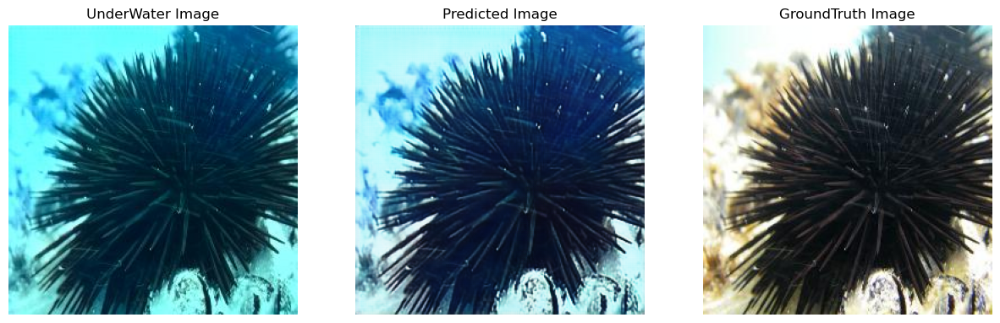

22/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264375_00030607.jpg


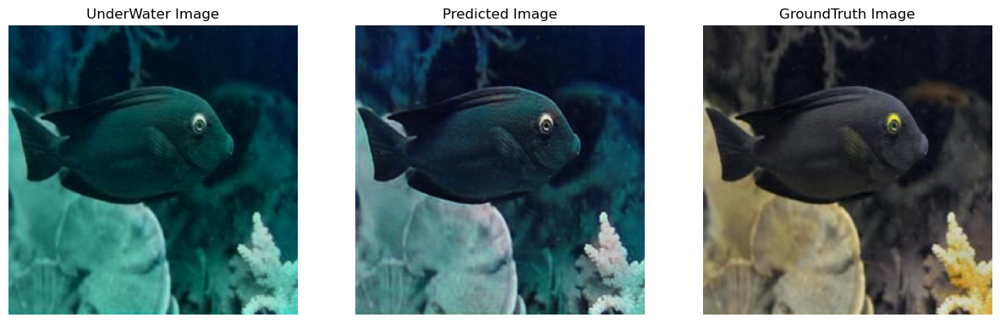

23/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264376_00021655.jpg


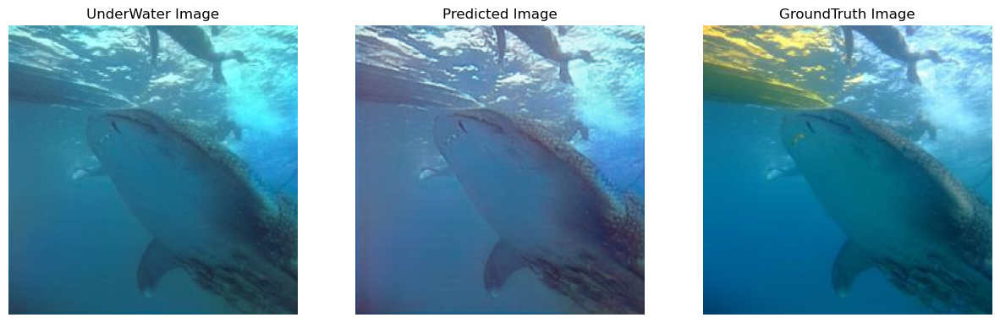

24/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264377_00033442.jpg


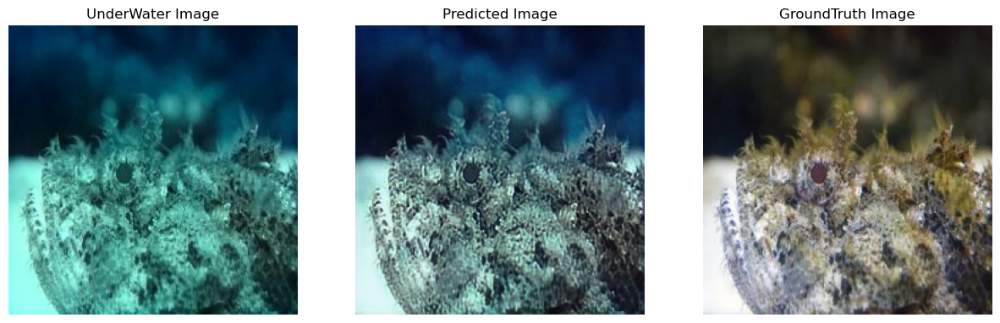

25/25 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264383_n02526121_667.JPEG


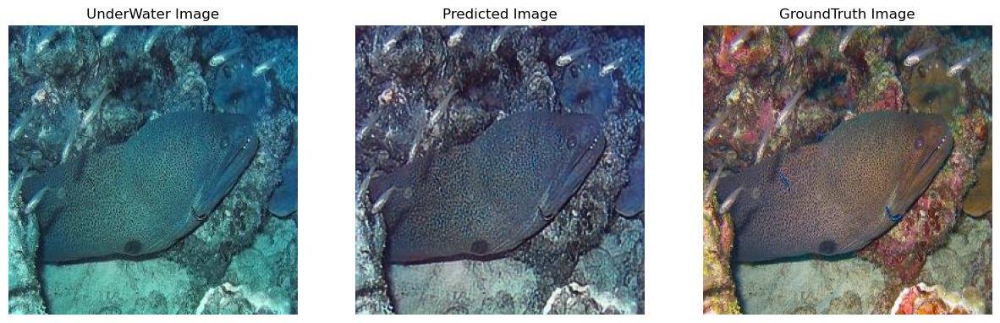

In [20]:
infer(train_x_paths,train_y_paths,n_images=25,save_sufix='train_res',save=True)